In [31]:
!pip install torch_snippets torch_summary --quiet
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary
from torch.utils.data import Dataset
import torch
from torchvision import transforms
from torch.utils.data import DataLoader

In [32]:
#img = Image.open('testA/00100.jpg')
#img.size

In [33]:
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

In [34]:
class Monet2Photo(Dataset):
    def __init__(self, monet, photo):
        self.monets = Glob(monet)
        self.photos = Glob(photo)

    def __getitem__(self, ix):
        monet = self.monets[ix % len(self.monets)]
        photo = choose(self.photos)
        monet = Image.open(monet).convert('RGB')
        photo = Image.open(photo).convert('RGB')
        return monet, photo

    def __len__(self): return max(len(self.monets), len(self.photos))
    def choose(self): return self[randint(len(self))]

    def collate_fn(self, batch):
        srcs, trgs = list(zip(*batch))

        srcs = torch.cat([transform(img)[None] for img in srcs], 0).to(device).float()
        trgs = torch.cat([transform(img)[None] for img in trgs], 0).to(device).float()
        return srcs.to(device), trgs.to(device)

In [35]:
#trn_ds = Monet2Photo('trainA', 'trainB')
#val_ds = Monet2Photo('testA', 'testB')


trn_ds = Monet2Photo('./HW_06_dataset/trainA', './HW_06_dataset/trainB')
val_ds = Monet2Photo('./HW_06_dataset/testA', './HW_06_dataset/testB')


trn_dl = DataLoader(trn_ds, batch_size=1, shuffle=True, collate_fn=trn_ds.collate_fn)
val_dl = DataLoader(val_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn)
print('done')

done


In [36]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)
print('done')

done


In [37]:
import torch.nn as nn

class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)
print('done')

done


In [38]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
    def forward(self, x):
        return self.model(x)
print('done')

done


In [39]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)
print('done')

done


In [40]:
@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)
print('done')

done


In [41]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B
print('done')

done


In [42]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D
print('done')

done


In [43]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0
print('done')

done


Epoch [1/20], Batch [6287/6287], Loss D: 0.3225, Loss G: 3.3041
Epoch [1/20] - Avg Loss D: 0.2086, Avg Loss G: 4.1422


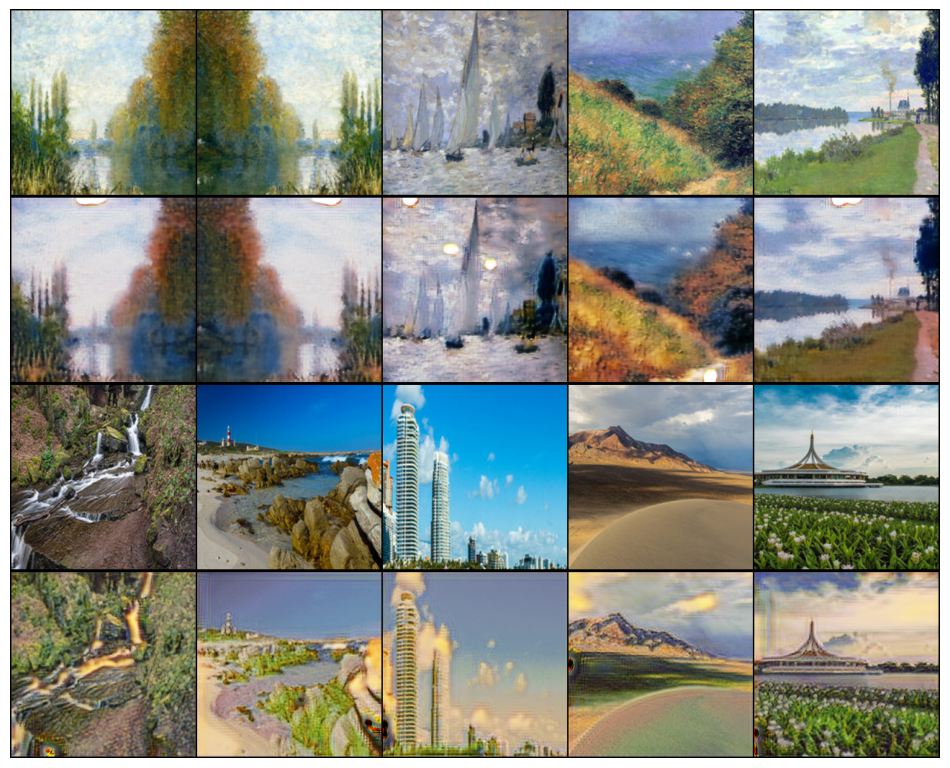

Epoch [2/20], Batch [6287/6287], Loss D: 0.1880, Loss G: 2.56990
Epoch [2/20] - Avg Loss D: 0.1999, Avg Loss G: 3.4970


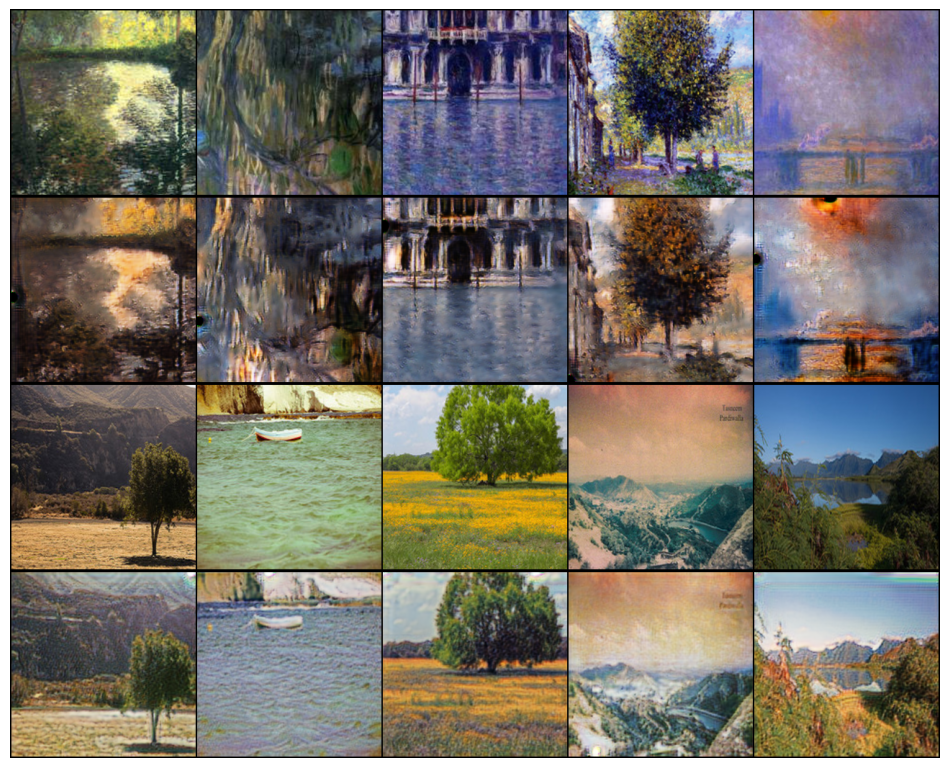

Epoch [3/20], Batch [6287/6287], Loss D: 0.2601, Loss G: 3.0343
Epoch [3/20] - Avg Loss D: 0.1866, Avg Loss G: 3.3405


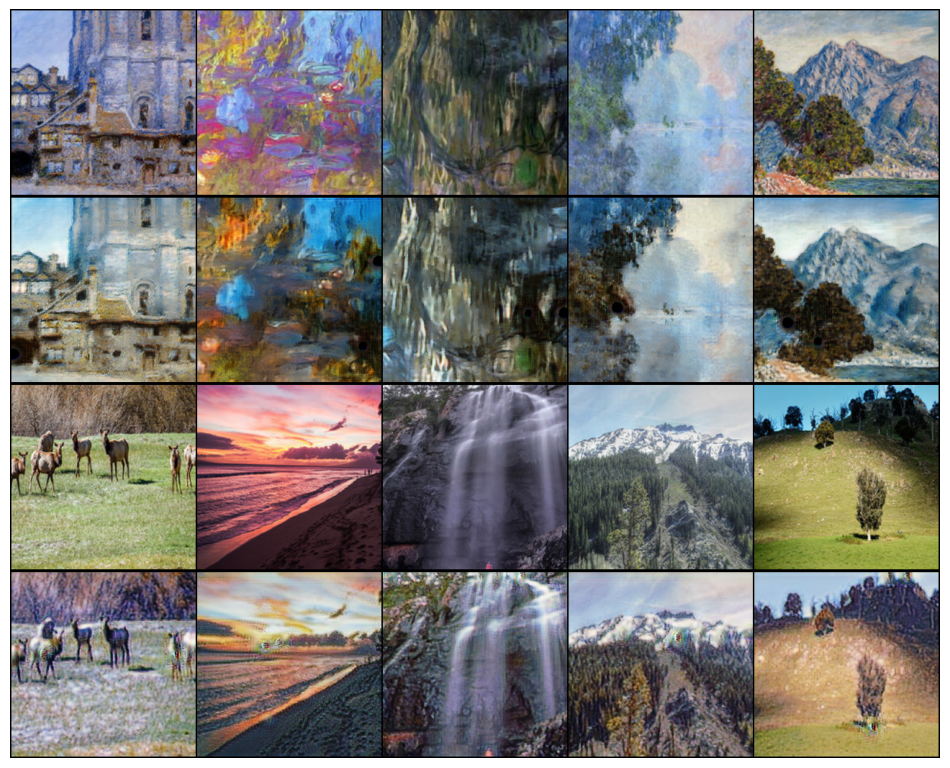

Epoch [4/20], Batch [6287/6287], Loss D: 0.3339, Loss G: 3.4389
Epoch [4/20] - Avg Loss D: 0.1795, Avg Loss G: 3.1728


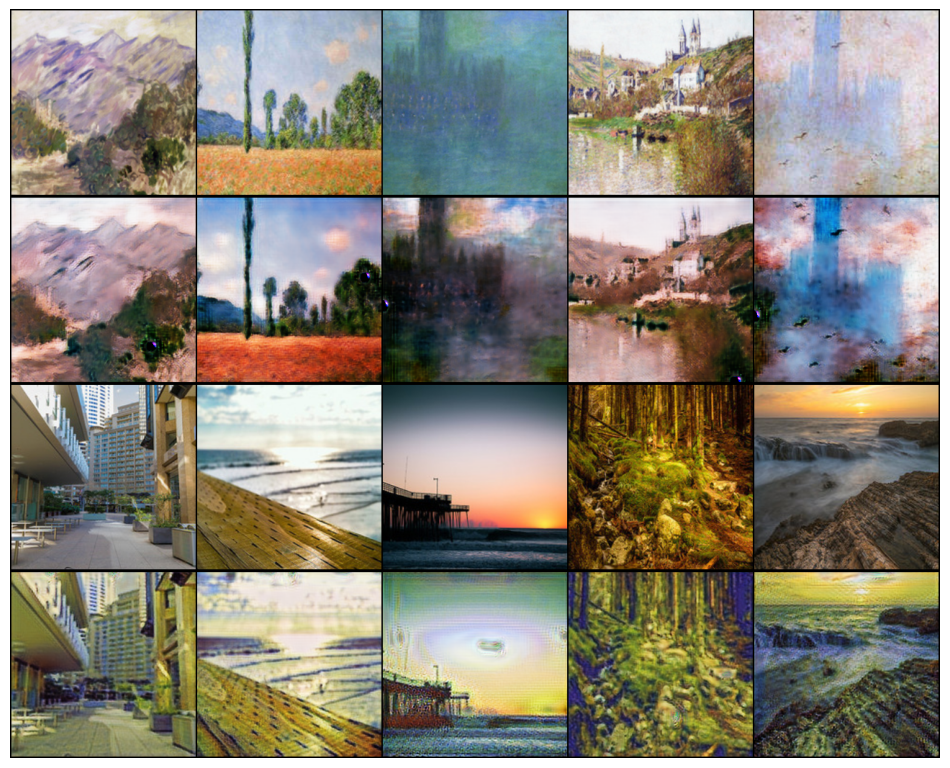

Epoch [5/20], Batch [6287/6287], Loss D: 0.1862, Loss G: 2.2430
Epoch [5/20] - Avg Loss D: 0.1739, Avg Loss G: 3.0731


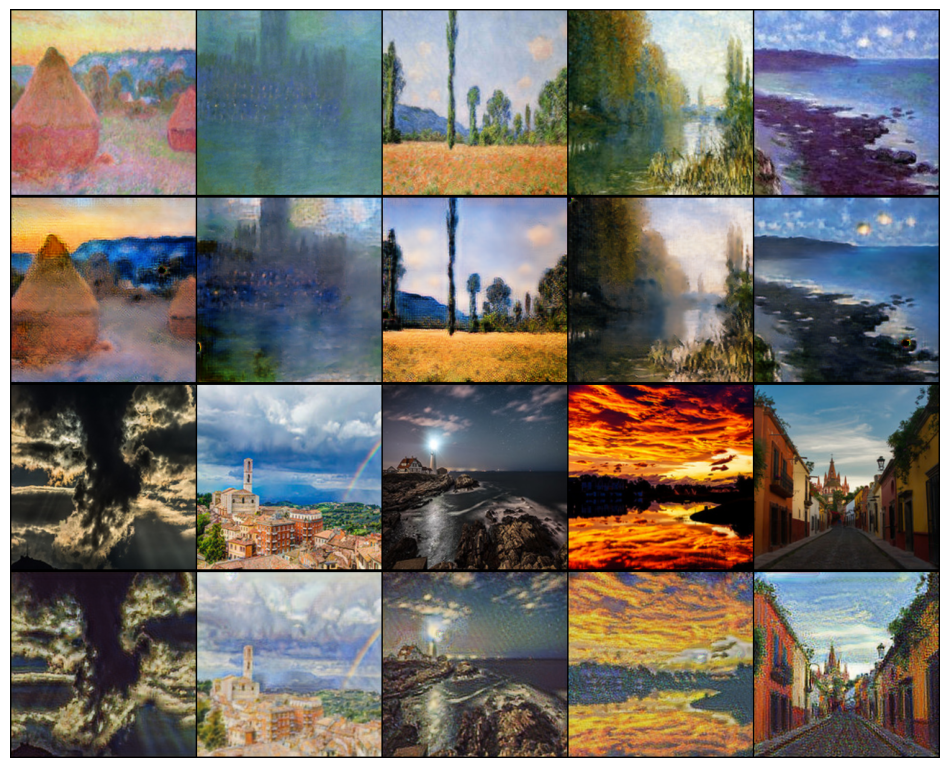

Epoch [6/20], Batch [6287/6287], Loss D: 0.0667, Loss G: 3.2800
Epoch [6/20] - Avg Loss D: 0.1801, Avg Loss G: 2.9410


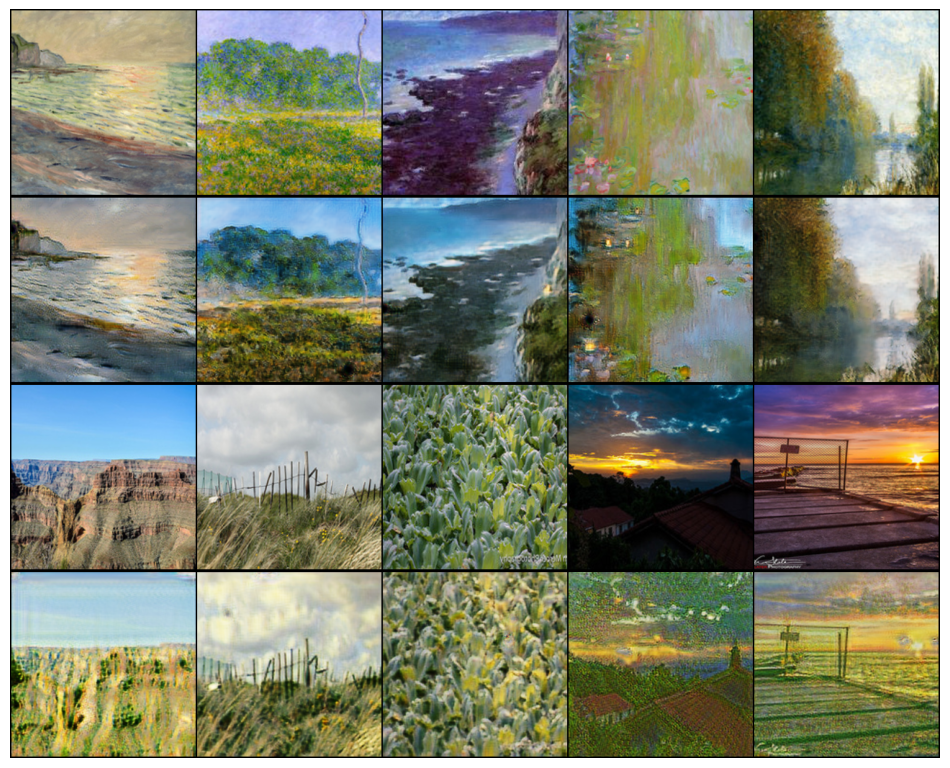

Epoch [7/20], Batch [6287/6287], Loss D: 0.0653, Loss G: 2.9901
Epoch [7/20] - Avg Loss D: 0.1712, Avg Loss G: 2.9182


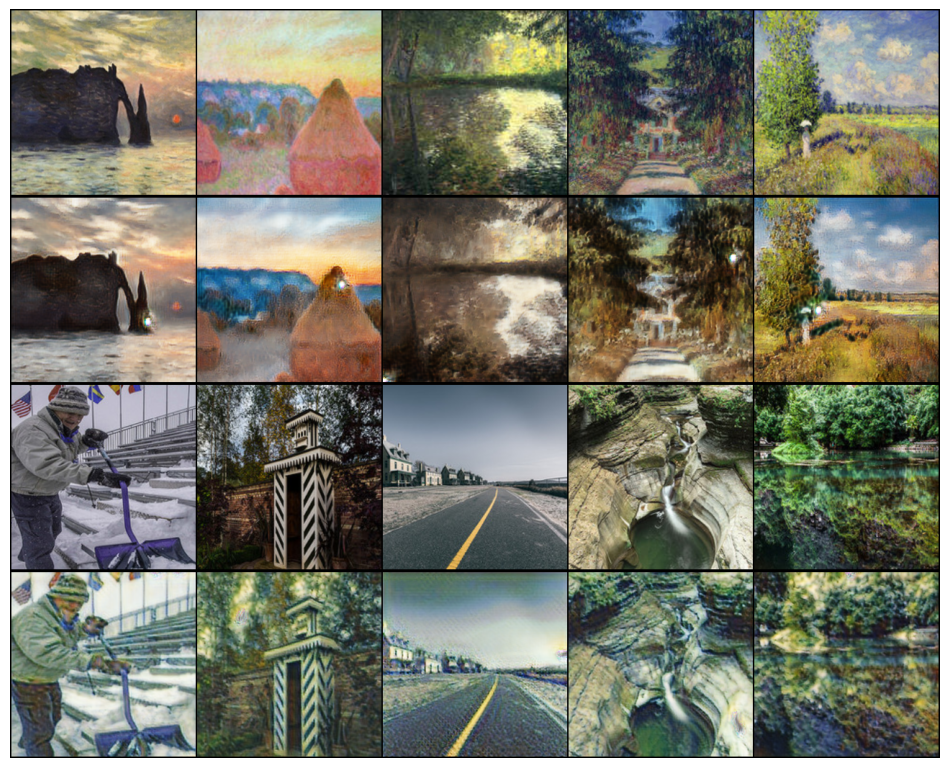

Epoch [8/20], Batch [6287/6287], Loss D: 0.2659, Loss G: 1.9739
Epoch [8/20] - Avg Loss D: 0.1709, Avg Loss G: 2.8619


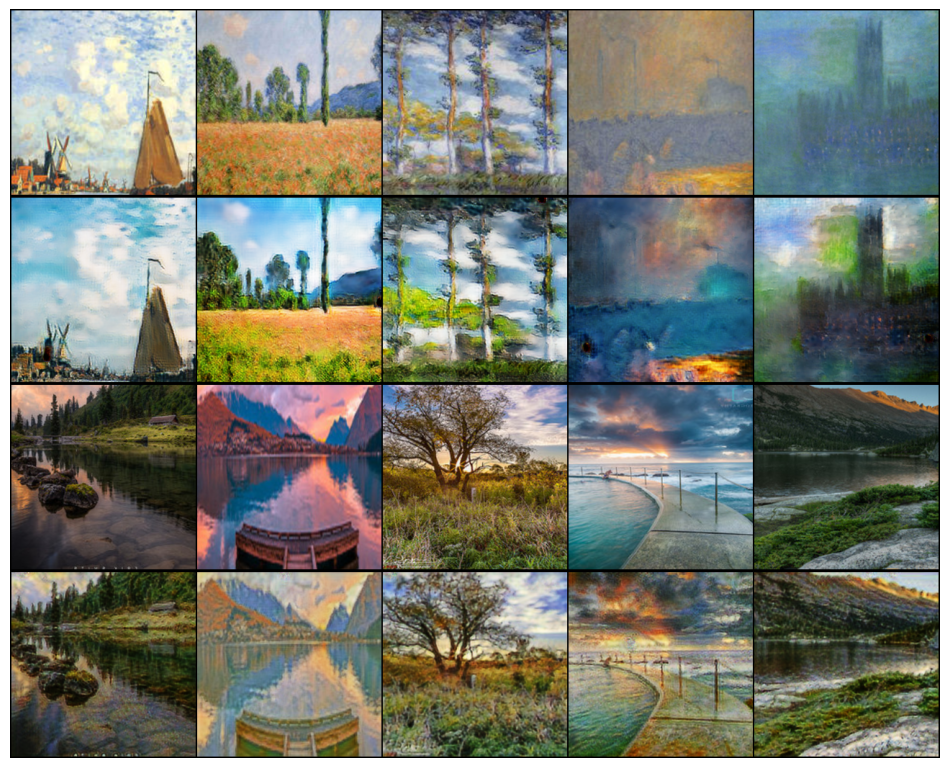

Epoch [9/20], Batch [6287/6287], Loss D: 0.3878, Loss G: 2.0433
Epoch [9/20] - Avg Loss D: 0.1622, Avg Loss G: 2.8436


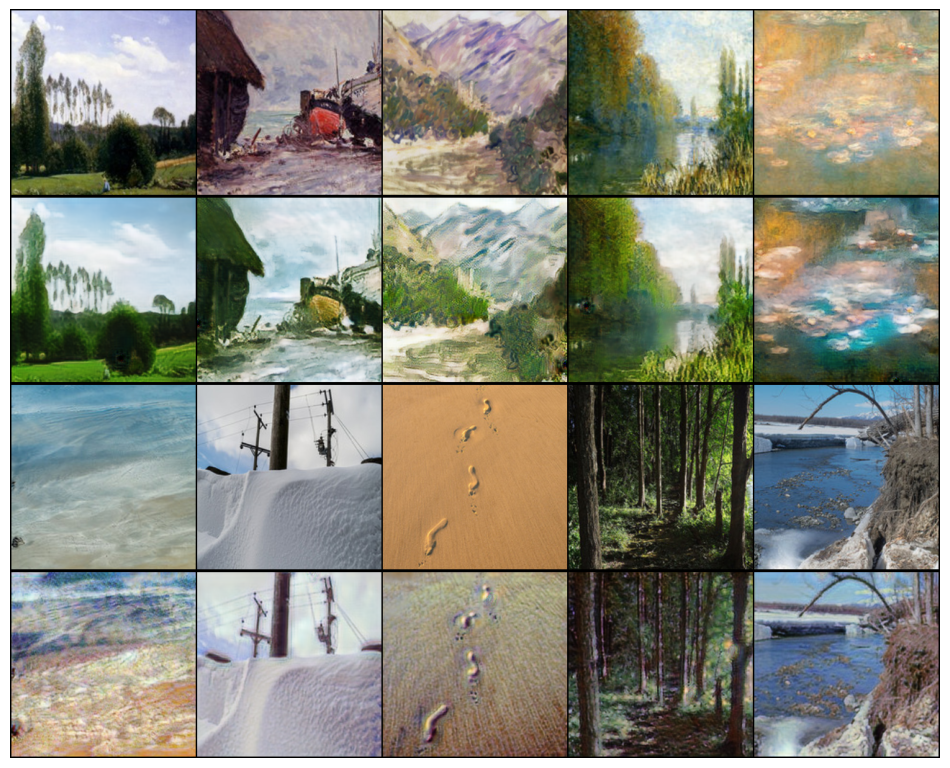

Epoch [10/20], Batch [6287/6287], Loss D: 0.2845, Loss G: 3.0212
Epoch [10/20] - Avg Loss D: 0.1690, Avg Loss G: 2.7804


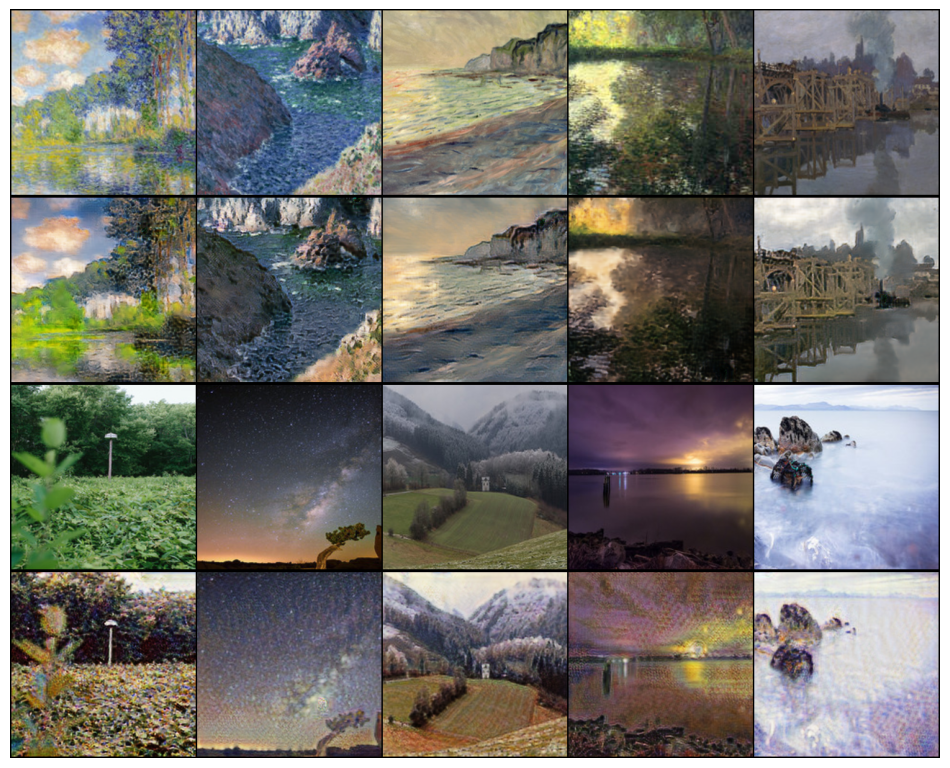

Epoch [11/20], Batch [6287/6287], Loss D: 0.2280, Loss G: 3.2971
Epoch [11/20] - Avg Loss D: 0.1665, Avg Loss G: 2.7335


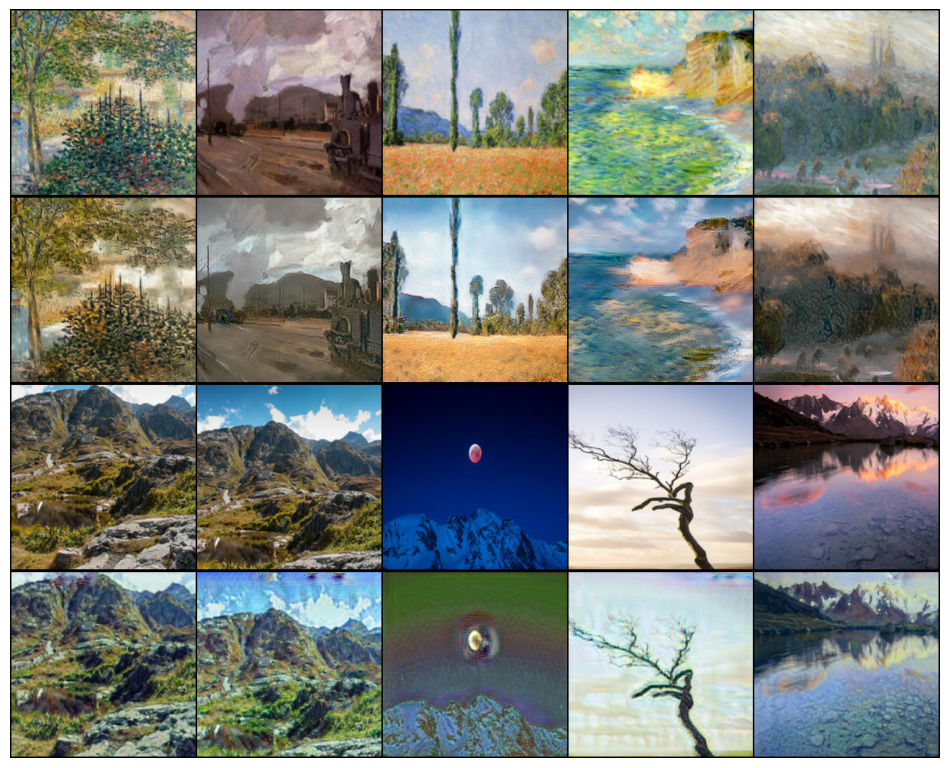

Epoch [12/20], Batch [6287/6287], Loss D: 0.0720, Loss G: 3.3392
Epoch [12/20] - Avg Loss D: 0.1630, Avg Loss G: 2.7113


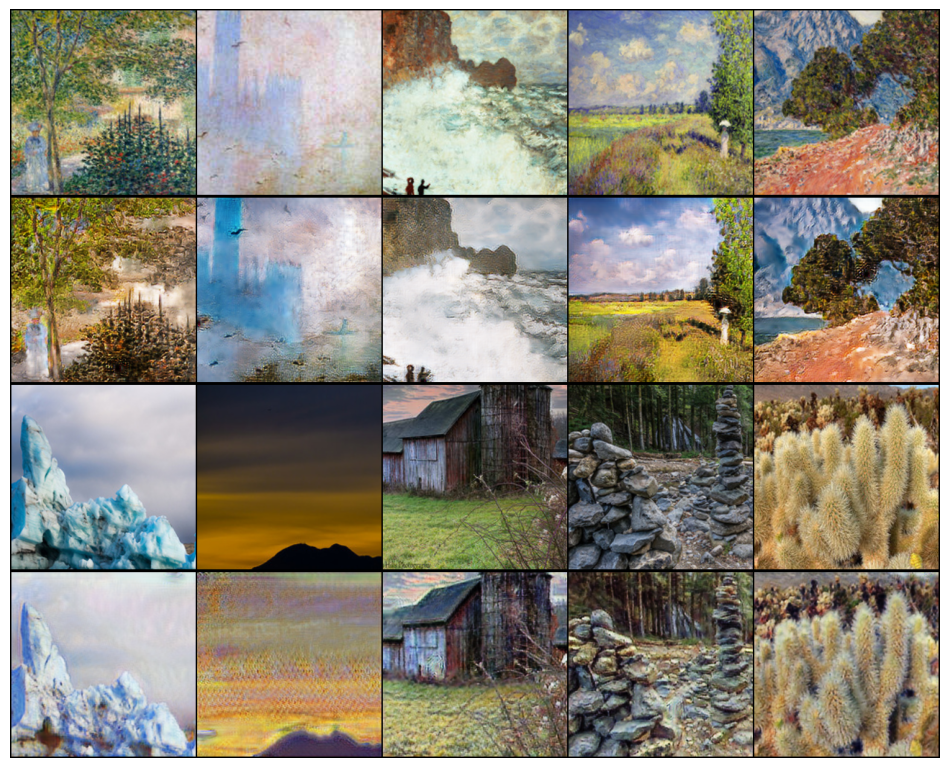

Epoch [13/20], Batch [6287/6287], Loss D: 0.1339, Loss G: 2.1817
Epoch [13/20] - Avg Loss D: 0.1575, Avg Loss G: 2.6788


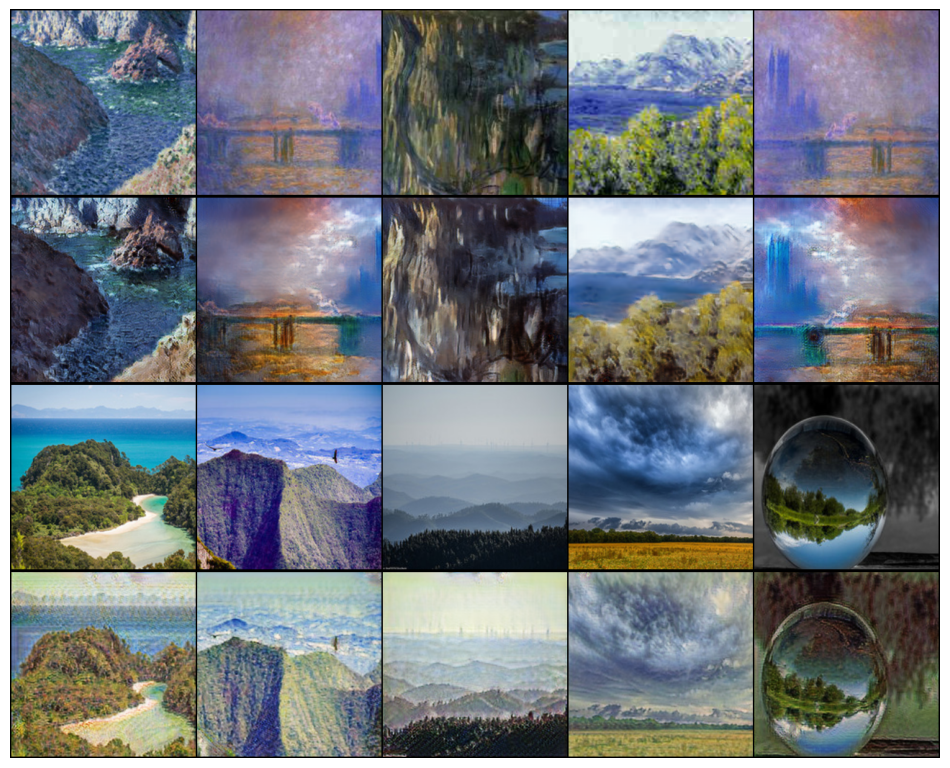

Epoch [14/20], Batch [6287/6287], Loss D: 0.1735, Loss G: 2.7599
Epoch [14/20] - Avg Loss D: 0.1483, Avg Loss G: 2.6829


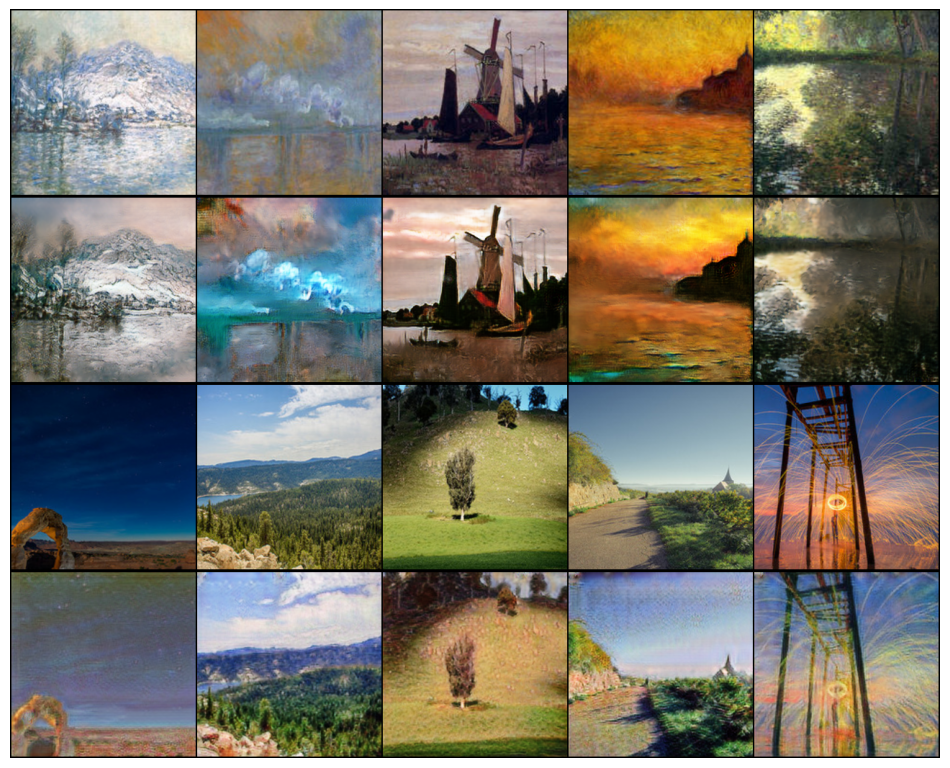

Epoch [15/20], Batch [6287/6287], Loss D: 0.1241, Loss G: 3.0380
Epoch [15/20] - Avg Loss D: 0.1385, Avg Loss G: 2.6740


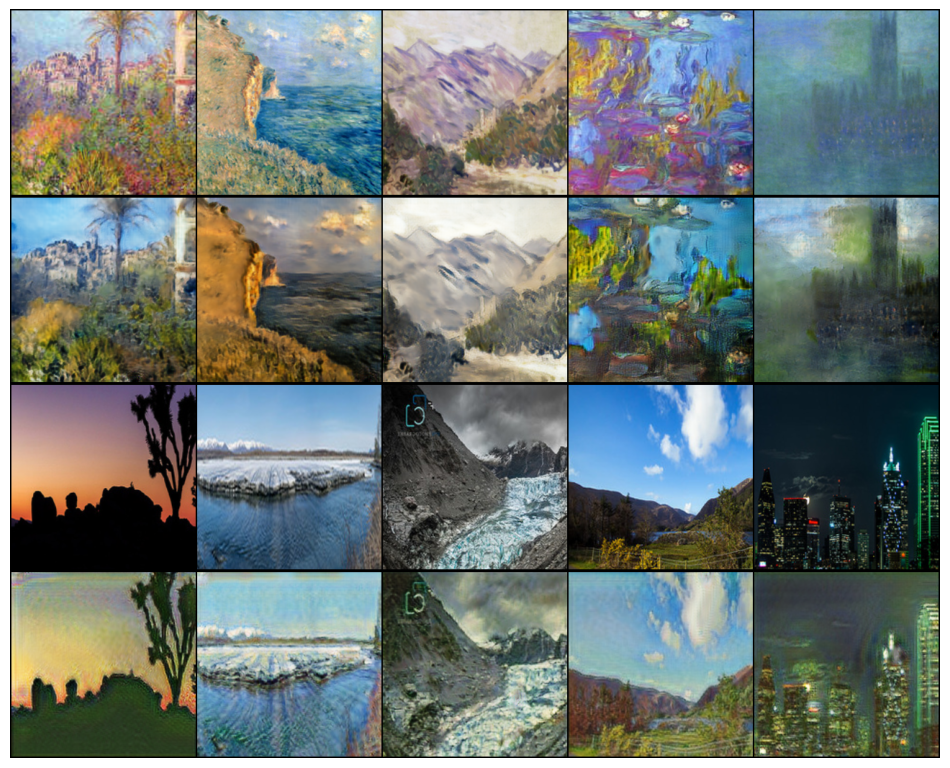

Epoch [16/20], Batch [6287/6287], Loss D: 0.0924, Loss G: 3.3813
Epoch [16/20] - Avg Loss D: 0.1250, Avg Loss G: 2.7022


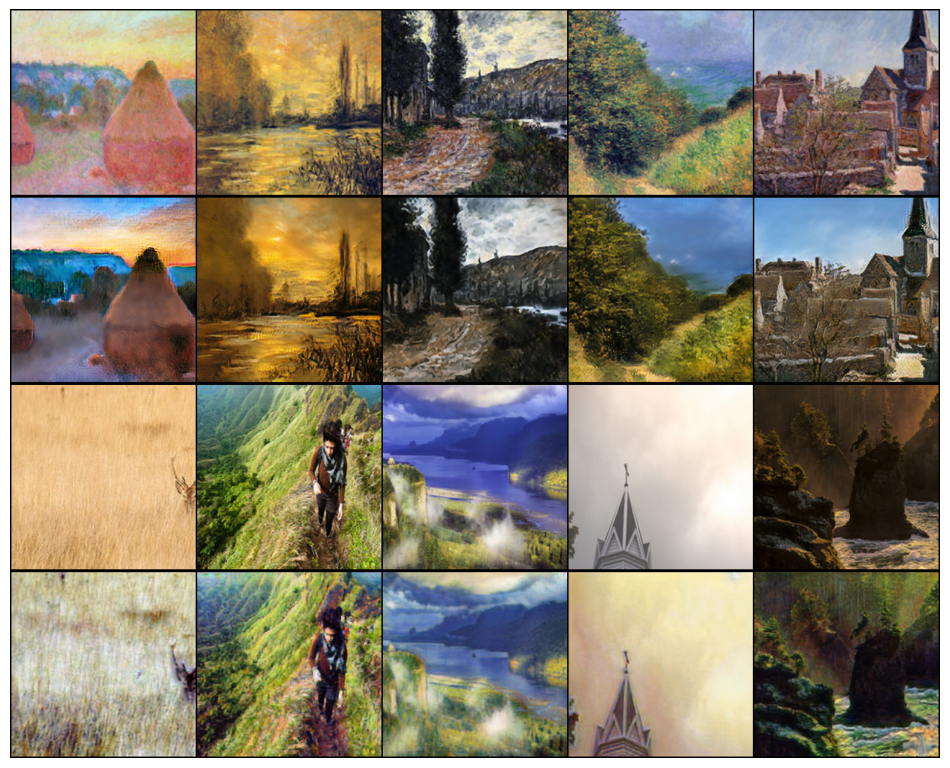

Epoch [17/20], Batch [6287/6287], Loss D: 0.0968, Loss G: 3.6553
Epoch [17/20] - Avg Loss D: 0.1160, Avg Loss G: 2.7009


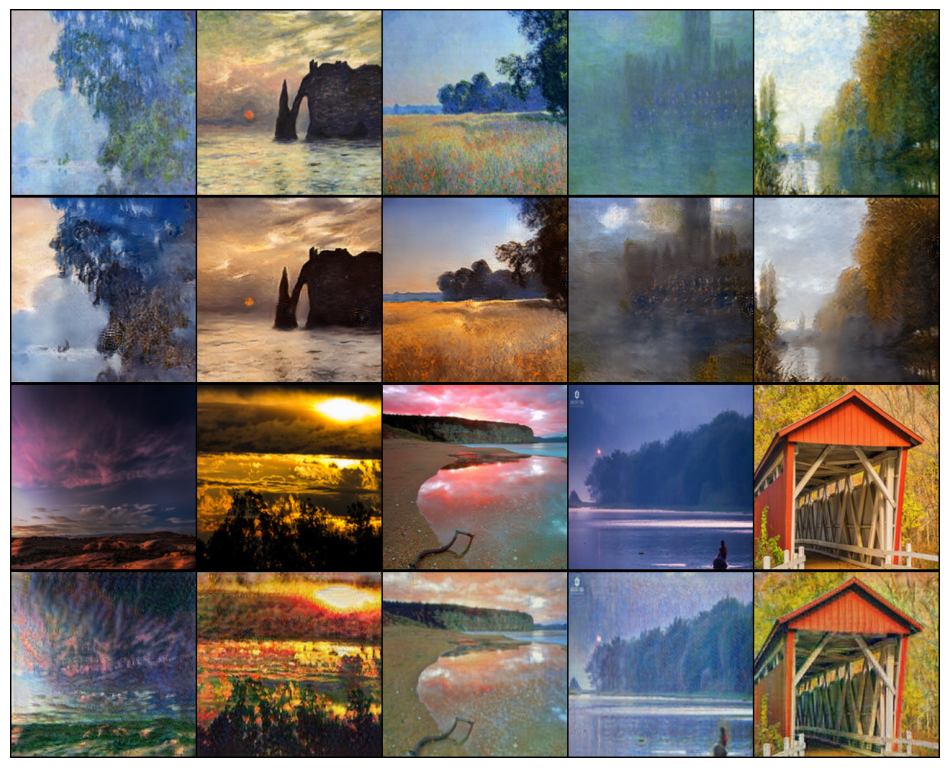

Epoch [18/20], Batch [6287/6287], Loss D: 0.0462, Loss G: 2.7657
Epoch [18/20] - Avg Loss D: 0.1117, Avg Loss G: 2.7004


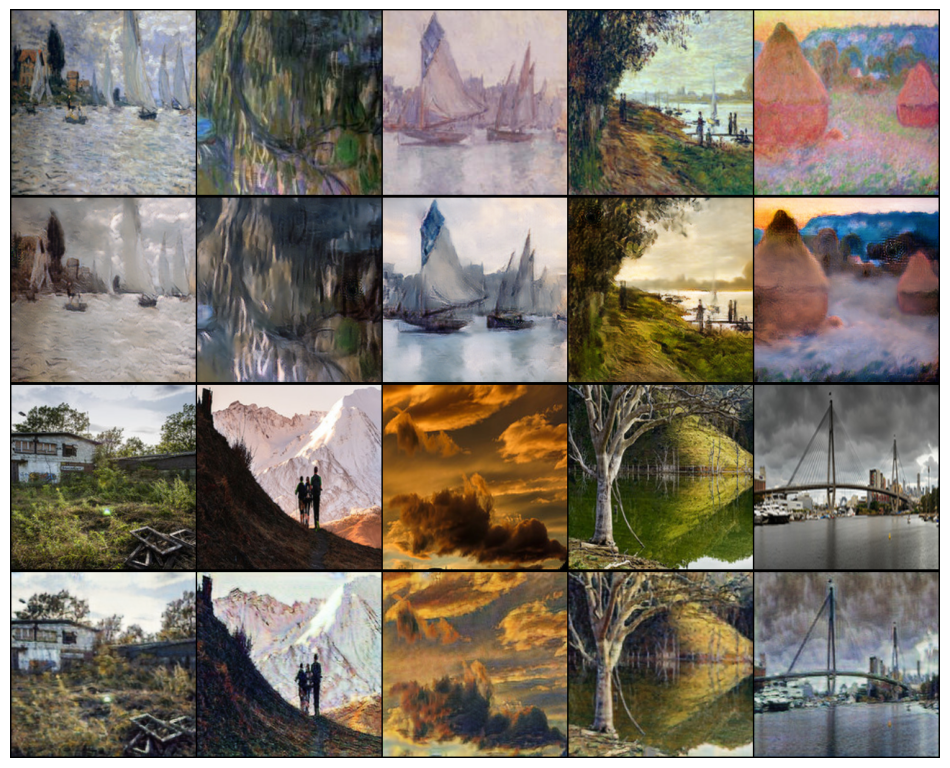

Epoch [19/20], Batch [6287/6287], Loss D: 0.0768, Loss G: 2.5473
Epoch [19/20] - Avg Loss D: 0.1107, Avg Loss G: 2.6753


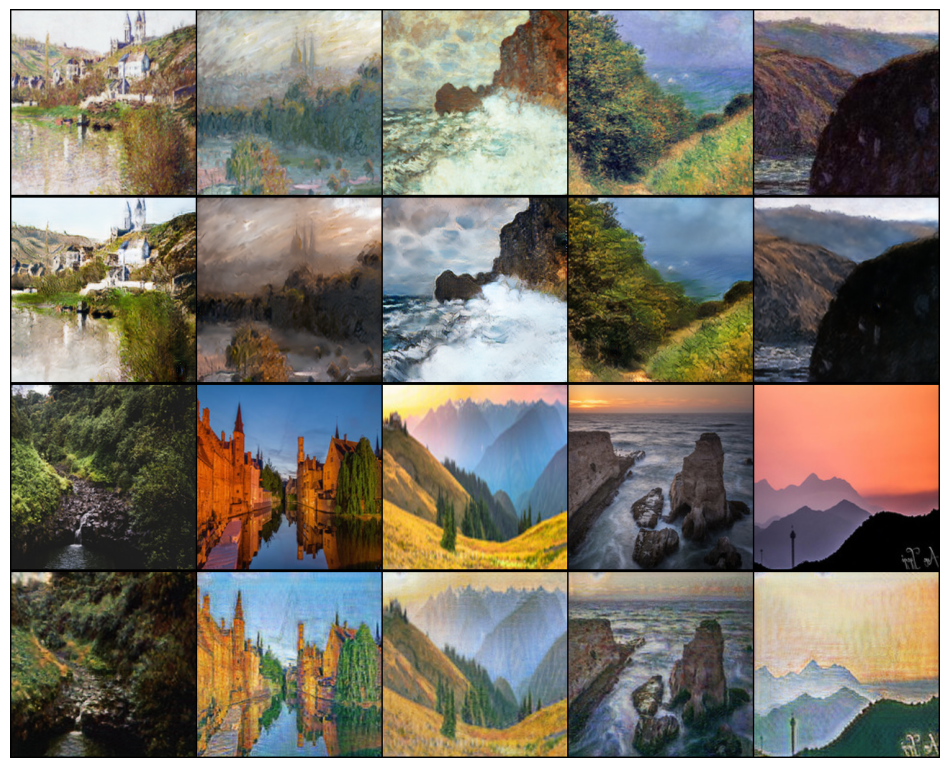

Epoch [20/20], Batch [6287/6287], Loss D: 0.0822, Loss G: 2.3147
Epoch [20/20] - Avg Loss D: 0.1092, Avg Loss G: 2.6517


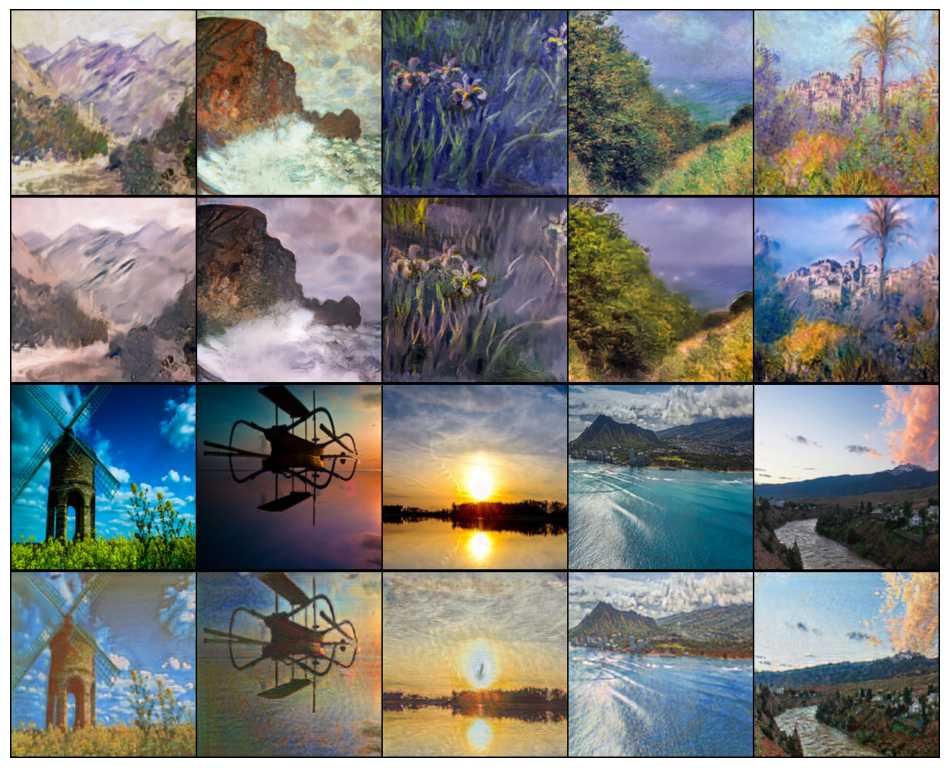

done


In [44]:
n_epochs = 20
for epoch in range(n_epochs):
    N = len(trn_dl)
    total_loss_D = 0
    total_loss_G = 0
    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB, G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        total_loss_D += loss_D.item()
        total_loss_G += loss_G.item()

        print(f'Epoch [{epoch+1}/{n_epochs}], Batch [{bx+1}/{N}], Loss D: {loss_D.item():.4f}, Loss G: {loss_G.item():.4f}', end='\r')

    avg_loss_D = total_loss_D / N
    avg_loss_G = total_loss_G / N
    print(f'\nEpoch [{epoch+1}/{n_epochs}] - Avg Loss D: {avg_loss_D:.4f}, Avg Loss G: {avg_loss_G:.4f}')

    generate_sample()
print('done')

Results can be seen above in the converted images after apoch 20.

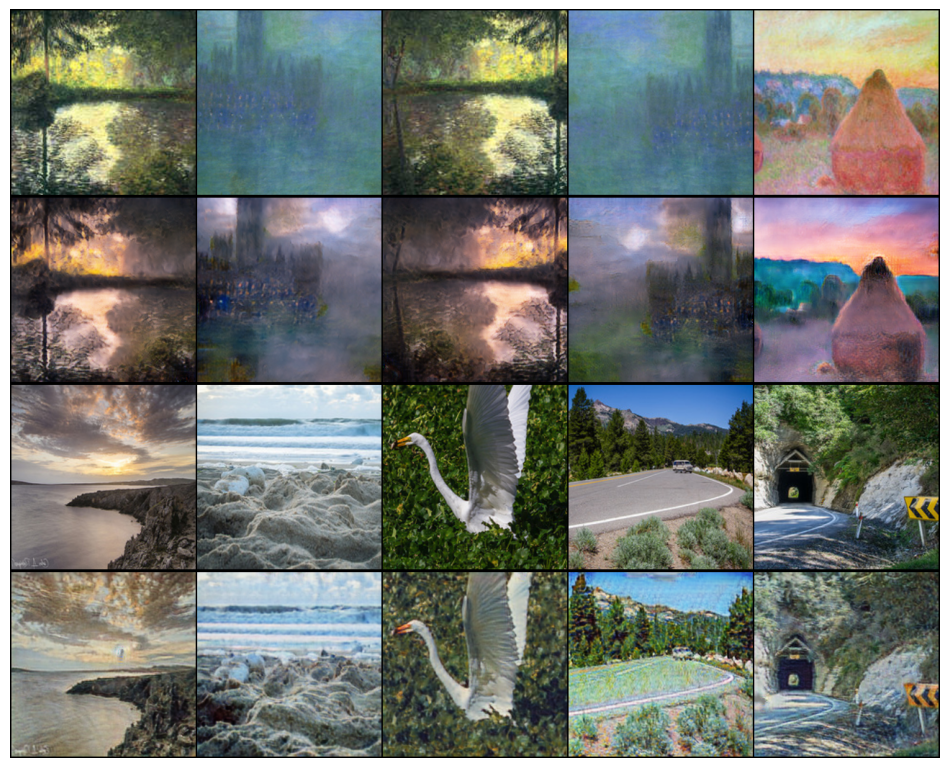

In [45]:
@torch.no_grad()
def show_generated_samples():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)

    real_A_grid = make_grid(real_A, nrow=5, normalize=True)
    fake_B_grid = make_grid(fake_B, nrow=5, normalize=True)
    real_B_grid = make_grid(real_B, nrow=5, normalize=True)
    fake_A_grid = make_grid(fake_A, nrow=5, normalize=True)

    image_grid = torch.cat((real_A_grid, fake_B_grid, real_B_grid, fake_A_grid), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

show_generated_samples()

In [46]:
def cyclegan_on_custom_image(image_path):
    custom_img = Image.open(image_path).convert('RGB')
    custom_img_tensor = transform(custom_img).unsqueeze(0).to(device)

    G_AB.eval()
    generated_img_tensor = G_AB(custom_img_tensor)

    generated_img = generated_img_tensor.squeeze(0).detach().cpu()
    generated_img = transforms.ToPILImage()(generated_img)

    generated_img.save("converted.png")
    print("CycleGAN applied to the custom image. The result is saved !!")

cyclegan_on_custom_image('Trial2.jpg')

CycleGAN applied to the custom image. The result is saved !!


In [47]:
import matplotlib.pyplot as plt

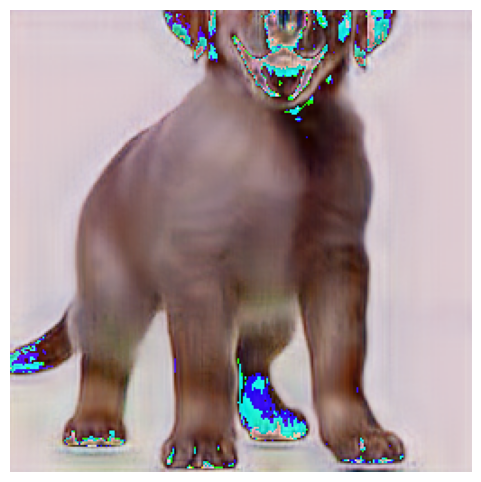

In [48]:
converted_img = Image.open("converted.png")

plt.figure(figsize=(6, 6))
plt.imshow(converted_img)
plt.axis('off')  
plt.show()